In [5]:
from dwave.embedding.pegasus import find_clique_embedding
from dwave.system.samplers import DWaveSampler
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import patches
import dwave.embedding
import dimod
import networkx as nx
import dwave_networkx as dnx

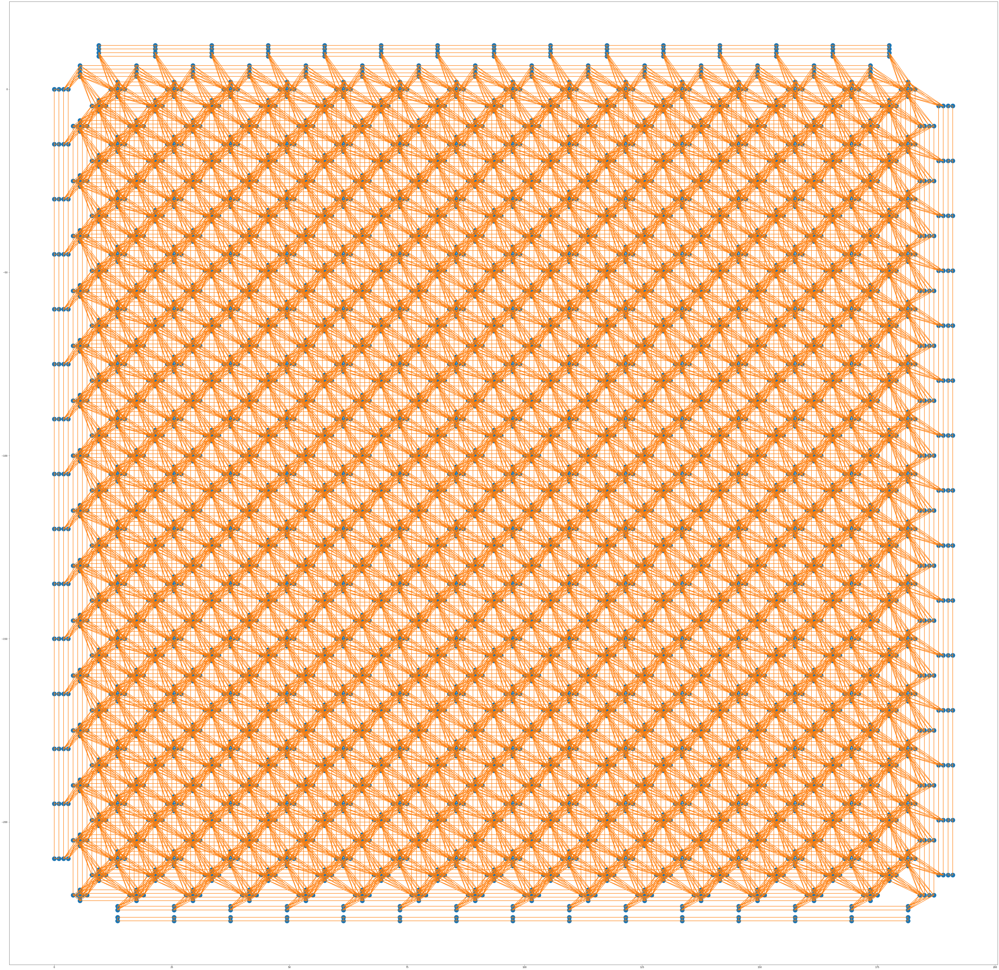

In [6]:
M = 16
nqs = 24*M*(M-1)
s0v = np.array([2, 2, 10, 10, 6, 6])
s0h = np.array([6, 6, 2, 2, 10, 10])
qd = 1
xd = 12
yd = 15
uc = np.array([[[0,0], [qd,0], [2*qd,0], [3*qd,0], 
      [4*qd,-2*yd/3], [5*qd,-2*yd/3], [6*qd,-2*yd/3], [7*qd,-2*yd/3], 
      [8*qd,-yd/3+qd/2], [9*qd,-yd/3+qd/2], [10*qd,-yd/3+qd/2], [11*qd,-yd/3+qd/2]],
        [[2*xd/3+3*qd/2,2*yd/3+3*qd-qd], [2*xd/3+3*qd/2,2*yd/3+3*qd-2*qd], [2*xd/3+3*qd/2,2*yd/3+3*qd-3*qd], [2*xd/3+3*qd/2,2*yd/3+3*qd-4*qd], 
         [xd/3+3*qd/2,2*yd/3+3*qd/2-5*qd], [xd/3+3*qd/2,2*yd/3+3*qd/2-6*qd], [xd/3+3*qd/2,2*yd/3+3*qd/2-7*qd], [xd/3+3*qd/2,2*yd/3+3*qd/2-8*qd], 
         [xd+3*qd/2,2*qd], [xd+3*qd/2,qd], [xd+3*qd/2,-qd], [xd+3*qd/2,-2*qd]]])
aw = np.array([[xd,0],[0,-yd]])
az = np.array([[0,-yd],[xd,0]])

def delta0(x,y):
    if x == y:
        return 1
    else:
        return 0
def renaming(u,w,z,k,M):
    if u == 0:
        k01 = [0,0,0,0,2,2,2,2,1,1,1,1]
    else:
        k01 = [1,1,1,1,0,0,0,0,2,2,2,2]
    k02 = [0,0,1,1,2,2,3,3,4,4,5,5]
    k03 = [0,1,0,1,0,1,0,1,0,1,0,1]
    x = (1-u)*w+u*(z+delta0(k01[k],2))
    y = (1-u)*(M-2-z+delta0(k01[k],0))+u*(M-1-w)
    zD = int((1-u)*(k01[k]/2*(7-3*k01[k]))+u*(-3*k01[k]**2/2+5*k01[k]/2+1))
    j = (1-u)*(k02[k]-k01[k]*(7-3*k01[k]))+u*(k02[k]-3*k01[k]**2+5*k01[k]-2)
    kD = k03[k]
    return (x,y,zD,u,j,kD)

couplers = []

fig, ax = plt.subplots(figsize=(80,80))
cmap = plt.rcParams['axes.prop_cycle'].by_key()['color']
qbcs = np.zeros((nqs,2))
for u in range(2):
    for w in range(M):
        for k in range(12):
            for z in range(M-1):
                qbcs[z+(M-1)*(k+12*(w+M*u))] = w*aw[u] + z*az[u] + uc[u][k]
                (x,y,zD,i,j,kD) = renaming(u,w,z,k,M)
                #ax.annotate("("+str(u)+","+str(w)+",\n "+str(k)+","+str(z)+")", (qbcs[z+(M-1)*(k+12*(w+M*u))][0], qbcs[z+(M-1)*(k+12*(w+M*u))][1]), size=35)
                #ax.annotate("("+str(x)+","+str(y)+","+str(zD)+",\n "+str(i)+","+str(j)+","+str(kD)+")", (qbcs[z+(M-1)*(k+12*(w+M*u))][0], qbcs[z+(M-1)*(k+12*(w+M*u))][1]), size=35)
                
for u in range(2):
    for w in range(M):
        for k in range(12):
            for z in range(M-2):
                p1 = qbcs[z+(M-1)*(k+12*(w+M*u))]
                p2 = qbcs[z+1+(M-1)*(k+12*(w+M*u))]
                ax.plot([p1[0],p2[0]],[p1[1],p2[1]], cmap[1], lw=2)
                couplers.append([z+(M-1)*(k+12*(w+M*u)),z+1+(M-1)*(k+12*(w+M*u))])
for u in range(2):
    for w in range(M):
        for k in range(6):
            for z in range(M-1):
                p1 = qbcs[z+(M-1)*(2*k+12*(w+M*u))]
                p2 = qbcs[z+(M-1)*(2*k+1+12*(w+M*u))]
                ax.plot([p1[0],p2[0]],[p1[1],p2[1]], cmap[1], lw=2)
                couplers.append([z+(M-1)*(2*k+12*(w+M*u)),z+(M-1)*(2*k+1+12*(w+M*u))])
def delta(x,y):
    if x < y:
        return 1
    else:
        return 0
for w in range(M):
    for k in range(12):
        for j in range(12):
            for z in range(M-1):
                if M-1 > w-delta(k,s0h[int(j/2)]) > -1:
                    p1 = qbcs[z+(M-1)*(k+12*(w+M*0))]
                    p2 = qbcs[w-delta(k,s0h[int(j/2)])+(M-1)*(j+12*(z+delta(j,s0v[int(k/2)])+M*1))]
                    ax.plot([p1[0],p2[0]],[p1[1],p2[1]], cmap[1], lw=2)
                    couplers.append([z+(M-1)*(k+12*(w+M*0)),w-delta(k,s0h[int(j/2)])+(M-1)*(j+12*(z+delta(j,s0v[int(k/2)])+M*1))])

qbcsx = qbcs[:,0]
qbcsy = qbcs[:,1]

ax.scatter(qbcsx, qbcsy, s=400)

In [21]:
def delta0(x,y):
    if x == y:
        return 1
    else:
        return 0
def renaming_inv(x,y,zD,i,j,kD,M):
    u = i
    w = (1-u)*x+u*(M-1-y)
    z = (1-u)*(M-2-y+delta0(zD,0))+u*(x-delta0(zD,0))
    k = kD+2*j+4*zD*(1-2*u)+8*u
    return (u,w,z,k)
def qubit_index(x,y,zD,i,j,kD,M):
    (u,w,z,k) = renaming_inv(x,y,zD,i,j,kD,M)
    if 0 <= w <= M-1 and 0 <= z <= M-2:
        if x==0 and zD==1 and i==0 and j==0 and kD==0:
            return -1
        elif x==0 and zD==0:
            return -1
        elif x==M-1 and zD==2:
            return -1
        elif y==0 and zD==1 and i==1 and j==1 and kD==1:
            return -1
        elif y==0 and zD==0:
            return -1
        elif y==M-1 and zD==2:
            return -1
        else:
            return z+(M-1)*(k+12*(w+M*u))
    else:
        return -1
def flatten(t):
    return [item for item in t]
def qubit_index0(u,w,z,k,M):
    if 0 <= w <= M-1 and 0 <= z <= M-2:
        return z+(M-1)*(k+12*(w+M*u))
    else:
        return -1
def add_qubits(dictionary,item,value):
    if -1 not in value:
        dictionary[(item)] = value
def add_coupler(dictionary,c1,c2,value,existing_sites):
    if c1 in existing_sites and c2 in existing_sites:
        dictionary[(c1,c2)] = value

M=16

lattice_edges = {}

triangular_from_graphene = {}

for xD in range(M):
    for yD in range(M):
        
        add_qubits(triangular_from_graphene,str([-3*yD,3*xD+3*yD]),[qubit_index(xD,yD,0,0,0,0,M)])
        add_qubits(triangular_from_graphene,str([-3*yD+1,3*xD+3*yD]),[qubit_index(xD,yD,0,1,1,1,M)])
        add_qubits(triangular_from_graphene,str([-3*yD,3*xD+3*yD+1]),[qubit_index(xD,yD,0,1,0,0,M),qubit_index(xD,yD,0,0,1,1,M)])
        
        add_qubits(triangular_from_graphene,str([-3*yD-1,3*xD+3*yD+2]),[qubit_index(xD,yD,1,0,0,0,M)])
        add_qubits(triangular_from_graphene,str([-3*yD,3*xD+3*yD+2]),[qubit_index(xD,yD,1,1,1,1,M)])
        add_qubits(triangular_from_graphene,str([-3*yD-1,3*xD+3*yD+3]),[qubit_index(xD,yD,1,1,0,0,M),qubit_index(xD,yD,1,0,1,1,M)])
        
        add_qubits(triangular_from_graphene,str([-3*yD-2,3*xD+3*yD+4]),[qubit_index(xD,yD,2,0,0,0,M)])
        add_qubits(triangular_from_graphene,str([-3*yD-1,3*xD+3*yD+4]),[qubit_index(xD,yD,2,1,1,1,M)])
        add_qubits(triangular_from_graphene,str([-3*yD-2,3*xD+3*yD+5]),[qubit_index(xD,yD,2,1,0,0,M),qubit_index(xD,yD,2,0,1,1,M)])

#We need another loop over xD and yD, because then we have info regarding which lattice sites made it on the Pegasus
for xD in range(M):
    for yD in range(M):
        
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD]),str([-3*(yD-1)-2,3*(xD-1)+3*(yD-1)+5]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD]),str([-3*yD,3*(xD-1)+3*yD+2]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD]),str([-3*yD-1,3*(xD-1)+3*yD+3]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD]),str([-3*yD-1,3*(xD-1)+3*yD+4]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD]),str([-3*yD,3*xD+3*yD+1]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD]),str([-3*yD+1,3*xD+3*yD]),1.,triangular_from_graphene.keys())
        
        add_coupler(lattice_edges,str([-3*yD+1,3*xD+3*yD]),str([-3*(yD-1)-2,3*(xD-1)+3*(yD-1)+5]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD+1,3*xD+3*yD]),str([-3*yD,3*xD+3*yD+1]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD+1,3*xD+3*yD]),str([-3*(yD-1)-1,3*xD+3*(yD-1)+3]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD+1,3*xD+3*yD]),str([-3*(yD-1)-2,3*xD+3*(yD-1)+4]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD+1,3*xD+3*yD]),str([-3*(yD-1)-1,3*xD+3*(yD-1)+2]),1.,triangular_from_graphene.keys())
        
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+1]),str([-3*yD-1,3*(xD-1)+3*yD+4]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+1]),str([-3*yD-1,3*xD+3*yD+2]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+1]),str([-3*yD,3*xD+3*yD+2]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+1]),str([-3*(yD-1)-2,3*xD+3*(yD-1)+4]),1.,triangular_from_graphene.keys())
        
        add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+2]),str([-3*yD-1,3*(xD-1)+3*yD+4]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+2]),str([-3*yD-2,3*(xD-1)+3*yD+5]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+2]),str([-3*yD-1,3*xD+3*yD+3]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+2]),str([-3*yD,3*xD+3*yD+2]),1.,triangular_from_graphene.keys())
        
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+2]),str([-3*yD-1,3*xD+3*yD+3]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+2]),str([-3*(yD-1)-2,3*xD+3*(yD-1)+5]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+2]),str([-3*(yD-1)-2,3*xD+3*(yD-1)+4]),1.,triangular_from_graphene.keys())
        
        add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+3]),str([-3*yD-2,3*xD+3*yD+4]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+3]),str([-3*yD-1,3*xD+3*yD+4]),1.,triangular_from_graphene.keys())
        
        add_coupler(lattice_edges,str([-3*yD-2,3*xD+3*yD+4]),str([-3*yD-2,3*xD+3*yD+5]),1.,triangular_from_graphene.keys())
        add_coupler(lattice_edges,str([-3*yD-2,3*xD+3*yD+4]),str([-3*yD-1,3*xD+3*yD+4]),1.,triangular_from_graphene.keys())
        
        add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+4]),str([-3*yD-2,3*xD+3*yD+5]),1.,triangular_from_graphene.keys())

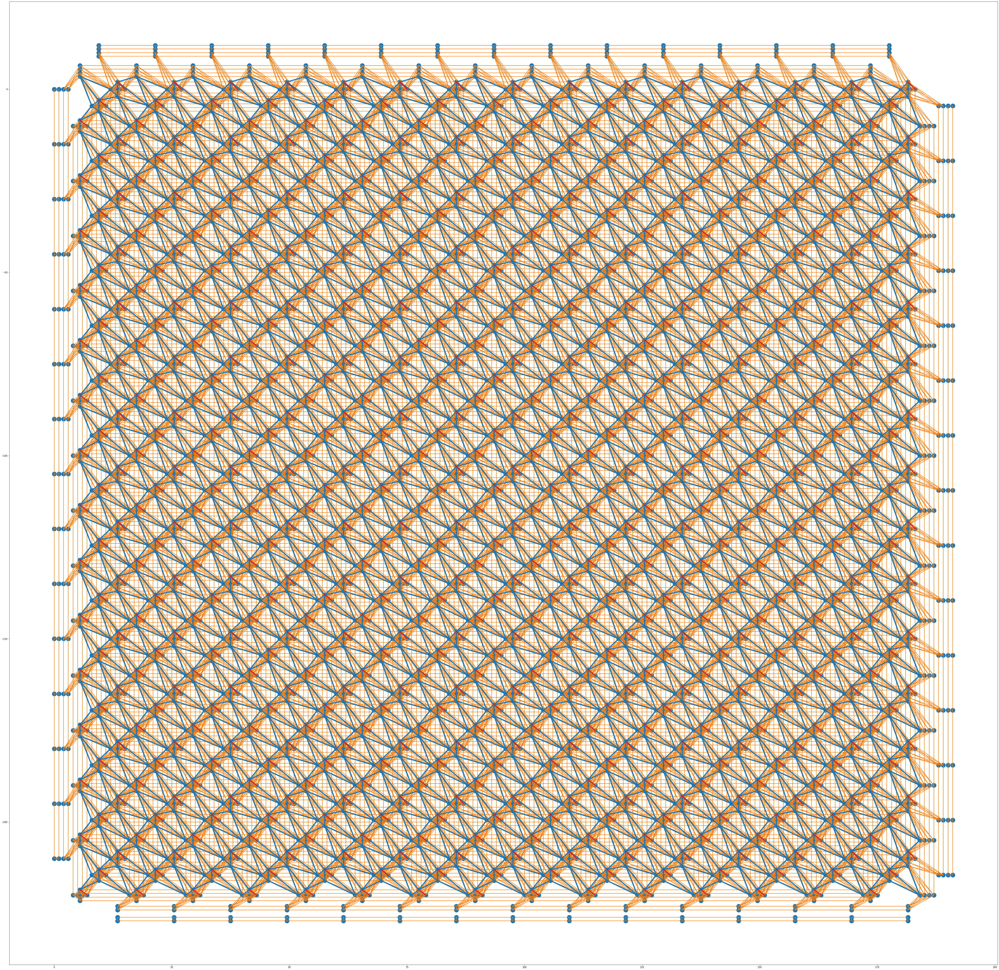

In [22]:
M = 16
nqs = 24*M*(M-1)
s0v = np.array([2, 2, 10, 10, 6, 6])
s0h = np.array([6, 6, 2, 2, 10, 10])
qd = 1
xd = 12
yd = 15
uc = np.array([[[0,0], [qd,0], [2*qd,0], [3*qd,0], 
      [4*qd,-2*yd/3], [5*qd,-2*yd/3], [6*qd,-2*yd/3], [7*qd,-2*yd/3], 
      [8*qd,-yd/3+qd/2], [9*qd,-yd/3+qd/2], [10*qd,-yd/3+qd/2], [11*qd,-yd/3+qd/2]],
        [[2*xd/3+3*qd/2,2*yd/3+3*qd-qd], [2*xd/3+3*qd/2,2*yd/3+3*qd-2*qd], [2*xd/3+3*qd/2,2*yd/3+3*qd-3*qd], [2*xd/3+3*qd/2,2*yd/3+3*qd-4*qd], 
         [xd/3+3*qd/2,2*yd/3+3*qd/2-5*qd], [xd/3+3*qd/2,2*yd/3+3*qd/2-6*qd], [xd/3+3*qd/2,2*yd/3+3*qd/2-7*qd], [xd/3+3*qd/2,2*yd/3+3*qd/2-8*qd], 
         [xd+3*qd/2,2*qd], [xd+3*qd/2,qd], [xd+3*qd/2,-qd], [xd+3*qd/2,-2*qd]]])
aw = np.array([[xd,0],[0,-yd]])
az = np.array([[0,-yd],[xd,0]])

def delta0(x,y):
    if x == y:
        return 1
    else:
        return 0
def renaming(u,w,z,k,M):
    if u == 0:
        k01 = [0,0,0,0,2,2,2,2,1,1,1,1]
    else:
        k01 = [1,1,1,1,0,0,0,0,2,2,2,2]
    k02 = [0,0,1,1,2,2,3,3,4,4,5,5]
    k03 = [0,1,0,1,0,1,0,1,0,1,0,1]
    x = (1-u)*w+u*(z+delta0(k01[k],2))
    y = (1-u)*(M-2-z+delta0(k01[k],0))+u*(M-1-w)
    zD = int((1-u)*(k01[k]/2*(7-3*k01[k]))+u*(-3*k01[k]**2/2+5*k01[k]/2+1))
    j = (1-u)*(k02[k]-k01[k]*(7-3*k01[k]))+u*(k02[k]-3*k01[k]**2+5*k01[k]-2)
    kD = k03[k]
    return (x,y,zD,u,j,kD)

def delta0(x,y):
    if x == y:
        return 1
    else:
        return 0
def renaming_inv(x,y,zD,i,j,kD,M):
    u = i
    w = (1-u)*x+u*(M-1-y)
    z = (1-u)*(M-2-y+delta0(zD,0))+u*(x-delta0(zD,0))
    k = kD+2*j+4*zD*(1-2*u)+8*u
    return (u,w,z,k)
def qubit_index(x,y,zD,i,j,kD,M):
    (u,w,z,k) = renaming_inv(x,y,zD,i,j,kD,M)
    return z+(M-1)*(k+12*(w+M*u))

fig, ax = plt.subplots(figsize=(80,80))
cmap = plt.rcParams['axes.prop_cycle'].by_key()['color']
qbcs = np.zeros((nqs,2))
for u in range(2):
    for w in range(M):
        for k in range(12):
            for z in range(M-1):
                qbcs[z+(M-1)*(k+12*(w+M*u))] = w*aw[u] + z*az[u] + uc[u][k]
                (x,y,zD,i,j,kD) = renaming(u,w,z,k,M)
                #ax.annotate("("+str(u)+","+str(w)+",\n "+str(k)+","+str(z)+")", (qbcs[z+(M-1)*(k+12*(w+M*u))][0], qbcs[z+(M-1)*(k+12*(w+M*u))][1]), size=35)
                ax.annotate("("+str(x)+","+str(y)+","+str(zD)+",\n "+str(i)+","+str(j)+","+str(kD)+")", (qbcs[z+(M-1)*(k+12*(w+M*u))][0], qbcs[z+(M-1)*(k+12*(w+M*u))][1]), size=1)
                #ax.annotate(str(z+(M-1)*(k+12*(w+M*u)))+", "+str(qubit_index(x,y,zD,i,j,kD,M)), (qbcs[z+(M-1)*(k+12*(w+M*u))][0], qbcs[z+(M-1)*(k+12*(w+M*u))][1]), size=35)
                #ax.annotate(str(renaming_inv(x,y,zD,i,j,kD,M))+"\n"+str((u,w,z,k)), (qbcs[z+(M-1)*(k+12*(w+M*u))][0], qbcs[z+(M-1)*(k+12*(w+M*u))][1]), size=35)
                
for c in couplers:
    p1 = qbcs[c[0]]
    p2 = qbcs[c[1]]
    ax.plot([p1[0],p2[0]],[p1[1],p2[1]], cmap[1], lw=2)

for l in lattice_edges:
    p1 = qbcs[triangular_from_graphene[(l[0])][0]]
    p2 = qbcs[triangular_from_graphene[(l[1])][0]]
    ax.plot([p1[0],p2[0]],[p1[1],p2[1]], cmap[0], lw=5)

for t in triangular_from_graphene:
    if len(triangular_from_graphene[(t)]) == 1:
        ax.annotate(t, (qbcs[triangular_from_graphene[(t)][0]][0], qbcs[triangular_from_graphene[(t)][0]][1]), size=1)
    else:
        p1 = qbcs[triangular_from_graphene[(t)][0]]
        p2 = qbcs[triangular_from_graphene[(t)][1]]
        ax.plot([p1[0],p2[0]],[p1[1],p2[1]], cmap[3], lw=5)
        ax.annotate(t, ((p1[0]+p2[0])/2,(p1[1]+p2[1])/2), size=1)

qbcsx = qbcs[:,0]
qbcsy = qbcs[:,1]

ax.scatter(qbcsx, qbcsy, s=400)

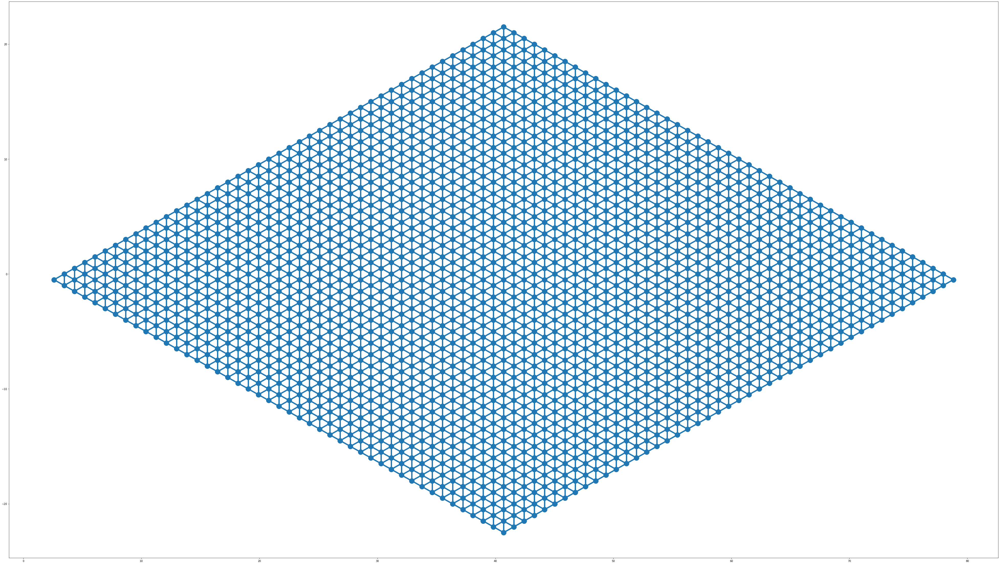

In [23]:
a1 = np.array([0,-1])
a2 = np.array([np.sqrt(3)/2,-1/2])
fig, ax = plt.subplots(figsize=(40*np.sqrt(3),40))
cmap = plt.rcParams['axes.prop_cycle'].by_key()['color']

coors = {}
for t in triangular_from_graphene.keys():
    coorst = eval(t)
    coors[(t)] = coorst[0]*a1+coorst[1]*a2

for l in lattice_edges:
    p1 = coors[(l[0])]
    p2 = coors[(l[1])]
    ax.plot([p1[0],p2[0]],[p1[1],p2[1]], cmap[0], lw=5)

coorsx = [coors[(item)][0] for item in coors.keys()]
coorsy = [coors[(item)][1] for item in coors.keys()]

ax.scatter(coorsx, coorsy, s=400)

In [27]:
def delta0(x,y):
    if x == y:
        return 1
    else:
        return 0
def renaming_inv(x,y,zD,i,j,kD,M):
    u = i
    w = (1-u)*x+u*(M-1-y)
    z = (1-u)*(M-2-y+delta0(zD,0))+u*(x-delta0(zD,0))
    k = kD+2*j+4*zD*(1-2*u)+8*u
    return (u,w,z,k)
def qubit_index(x,y,zD,i,j,kD,M):
    (u,w,z,k) = renaming_inv(x,y,zD,i,j,kD,M)
    if 0 <= w <= M-1 and 0 <= z <= M-2:
        if x==0 and zD==1 and i==0 and j==0 and kD==0:
            return -1
        elif x==0 and zD==0:
            return -1
        elif x==M-1 and zD==2:
            return -1
        elif y==0 and zD==1 and i==1 and j==1 and kD==1:
            return -1
        elif y==0 and zD==0:
            return -1
        elif y==M-1 and zD==2:
            return -1
        else:
            return z+(M-1)*(k+12*(w+M*u))
    else:
        return -1
def flatten(t):
    return [item for item in t]
def qubit_index0(u,w,z,k,M):
    if 0 <= w <= M-1 and 0 <= z <= M-2:
        return z+(M-1)*(k+12*(w+M*u))
    else:
        return -1
def add_qubits(dictionary,item,value,nodelist_set,target_edgelist):
    if set(value) <= nodelist_set:
        if len(value) == 1:
            dictionary[(item)] = value
        elif len(value) == 2:
            if (value[0],value[1]) in target_edgelist:
                dictionary[(item)] = [value[0],value[1]]
            elif (value[1],value[0]) in target_edgelist:
                dictionary[(item)] = [value[1],value[0]]
def add_coupler(dictionary,c1,c2,value,triangular_from_graphene,target_edgelist):
    if c1 in triangular_from_graphene.keys() and c2 in triangular_from_graphene.keys():
        for i in triangular_from_graphene[(c1)]:
            for j in triangular_from_graphene[(c2)]:
                if (i,j) in target_edgelist:
                    dictionary[(c1,c2)] = value
                elif (j,i) in target_edgelist:
                    dictionary[(c2,c1)] = value

def get_triangular_lattice_from_pegasus(M):
    sampler = DWaveSampler(profile='jvodebfree')
    nodelist, target_edgelist, target_adjacency = sampler.structure
    nodelist_set = set(nodelist)
    lattice_edges = {}
    triangular_from_graphene = {}
    for xD in range(M):
        for yD in range(M):
            add_qubits(triangular_from_graphene,str([-3*yD,3*xD+3*yD]),[qubit_index(xD,yD,0,0,0,0,M)],nodelist_set,target_edgelist)
            add_qubits(triangular_from_graphene,str([-3*yD+1,3*xD+3*yD]),[qubit_index(xD,yD,0,1,1,1,M)],nodelist_set,target_edgelist)
            add_qubits(triangular_from_graphene,str([-3*yD,3*xD+3*yD+1]),[qubit_index(xD,yD,0,1,0,0,M),qubit_index(xD,yD,0,0,1,1,M)],nodelist_set,target_edgelist)
            
            add_qubits(triangular_from_graphene,str([-3*yD-1,3*xD+3*yD+2]),[qubit_index(xD,yD,1,0,0,0,M)],nodelist_set,target_edgelist)
            add_qubits(triangular_from_graphene,str([-3*yD,3*xD+3*yD+2]),[qubit_index(xD,yD,1,1,1,1,M)],nodelist_set,target_edgelist)
            add_qubits(triangular_from_graphene,str([-3*yD-1,3*xD+3*yD+3]),[qubit_index(xD,yD,1,1,0,0,M),qubit_index(xD,yD,1,0,1,1,M)],nodelist_set,target_edgelist)
            
            add_qubits(triangular_from_graphene,str([-3*yD-2,3*xD+3*yD+4]),[qubit_index(xD,yD,2,0,0,0,M)],nodelist_set,target_edgelist)
            add_qubits(triangular_from_graphene,str([-3*yD-1,3*xD+3*yD+4]),[qubit_index(xD,yD,2,1,1,1,M)],nodelist_set,target_edgelist)
            add_qubits(triangular_from_graphene,str([-3*yD-2,3*xD+3*yD+5]),[qubit_index(xD,yD,2,1,0,0,M),qubit_index(xD,yD,2,0,1,1,M)],nodelist_set,target_edgelist)
            
    #We need another loop over xD and yD, because then we have info regarding which lattice sites made it on the Pegasus
    for xD in range(M):
        for yD in range(M):
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD]),str([-3*(yD-1)-2,3*(xD-1)+3*(yD-1)+5]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD]),str([-3*yD,3*(xD-1)+3*yD+2]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD]),str([-3*yD-1,3*(xD-1)+3*yD+3]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD]),str([-3*yD-1,3*(xD-1)+3*yD+4]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD]),str([-3*yD,3*xD+3*yD+1]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD]),str([-3*yD+1,3*xD+3*yD]),1.,triangular_from_graphene,target_edgelist)
            
            add_coupler(lattice_edges,str([-3*yD+1,3*xD+3*yD]),str([-3*(yD-1)-2,3*(xD-1)+3*(yD-1)+5]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD+1,3*xD+3*yD]),str([-3*yD,3*xD+3*yD+1]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD+1,3*xD+3*yD]),str([-3*(yD-1)-1,3*xD+3*(yD-1)+3]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD+1,3*xD+3*yD]),str([-3*(yD-1)-2,3*xD+3*(yD-1)+4]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD+1,3*xD+3*yD]),str([-3*(yD-1)-1,3*xD+3*(yD-1)+2]),1.,triangular_from_graphene,target_edgelist)
            
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+1]),str([-3*yD-1,3*(xD-1)+3*yD+4]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+1]),str([-3*yD-1,3*xD+3*yD+2]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+1]),str([-3*yD,3*xD+3*yD+2]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+1]),str([-3*(yD-1)-2,3*xD+3*(yD-1)+4]),1.,triangular_from_graphene,target_edgelist)
            
            add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+2]),str([-3*yD-1,3*(xD-1)+3*yD+4]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+2]),str([-3*yD-2,3*(xD-1)+3*yD+5]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+2]),str([-3*yD-1,3*xD+3*yD+3]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+2]),str([-3*yD,3*xD+3*yD+2]),1.,triangular_from_graphene,target_edgelist)
            
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+2]),str([-3*yD-1,3*xD+3*yD+3]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+2]),str([-3*(yD-1)-2,3*xD+3*(yD-1)+5]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD,3*xD+3*yD+2]),str([-3*(yD-1)-2,3*xD+3*(yD-1)+4]),1.,triangular_from_graphene,target_edgelist)
            
            add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+3]),str([-3*yD-2,3*xD+3*yD+4]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+3]),str([-3*yD-1,3*xD+3*yD+4]),1.,triangular_from_graphene,target_edgelist)
            
            add_coupler(lattice_edges,str([-3*yD-2,3*xD+3*yD+4]),str([-3*yD-2,3*xD+3*yD+5]),1.,triangular_from_graphene,target_edgelist)
            add_coupler(lattice_edges,str([-3*yD-2,3*xD+3*yD+4]),str([-3*yD-1,3*xD+3*yD+4]),1.,triangular_from_graphene,target_edgelist)
            
            add_coupler(lattice_edges,str([-3*yD-1,3*xD+3*yD+4]),str([-3*yD-2,3*xD+3*yD+5]),1.,triangular_from_graphene,target_edgelist)
    #for item in triangular_from_graphene:
    #    if len(triangular_from_graphene[(item)]) == 1:
    #        triangular_from_graphene[(item)] = triangular_from_graphene[(item)][0]
    return triangular_from_graphene, lattice_edges

In [30]:
M = 16
embedding, Q = get_triangular_lattice_from_pegasus(M)
N = sum([1 for x in embedding.values()])
NP = sum([len(x) for x in embedding.values()])
#NP = 0
#for i in embedding.values():
#    if isinstance(i, list):
#        NP += len(i)
#    else:
#        NP += 1
print(NP, ' OF PHYSICAL QBITS USED FOR ', N, ' LOGICAL QBITS.')
f=open('F:\\IJS\\D-wave project\\Embeddings\\embedding_triangular_v3_Advantage_system6.1_qbits_'+str(N)+'_logical_bits_'+str(NP)+'_exact_1.txt','w')
f.write(str(embedding))
f.close()
f=open('F:\\IJS\\D-wave project\\Embeddings\\qubo_triangular_v3_Advantage_system6.1_qbits_'+str(N)+'_logical_bits_'+str(NP)+'_exact_1.txt','w')
f.write(str(Q))
f.close()

2673  OF PHYSICAL QBITS USED FOR  2008  LOGICAL QBITS.


KeyError: '[-24, 58]'

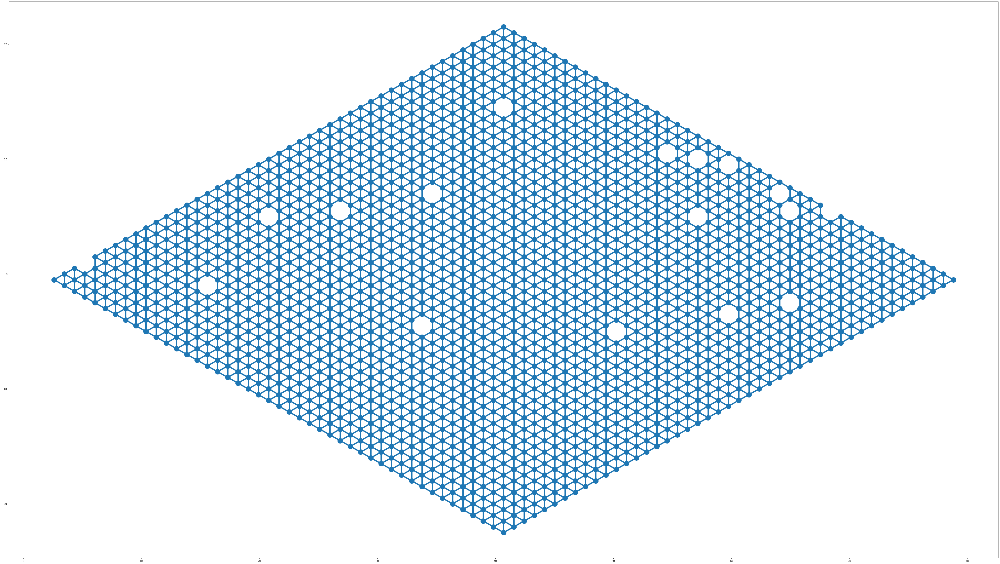

In [31]:
a1 = np.array([0,-1])
a2 = np.array([np.sqrt(3)/2,-1/2])
fig, ax = plt.subplots(figsize=(40*np.sqrt(3),40))
cmap = plt.rcParams['axes.prop_cycle'].by_key()['color']

coors = {}
for t in embedding.keys():
    coorst = eval(t)
    coors[(t)] = coorst[0]*a1+coorst[1]*a2

for l in Q:
    p1 = coors[(l[0])]
    p2 = coors[(l[1])]
    ax.plot([p1[0],p2[0]],[p1[1],p2[1]], cmap[0], lw=5)

coorsx = [coors[(item)][0] for item in coors.keys()]
coorsy = [coors[(item)][1] for item in coors.keys()]

ax.scatter(coorsx, coorsy, s=400)

p1 = coors[(str([-24, 58]))]
ax.scatter([p1[0]], [p1[1]], color=cmap[1], s=800)